# XGBOOST로 전력소비량 예측

- building 사용함
- 5.9 나옴
- building_type 전부 다 더미변수화 했더니 성능 잘 나옴

+ 위 결과는 xgb8의 결과
+ 이제 여기서 좀 더 바꿔보고 성능 좋아지면 다음 파일에서 파라미터 튜닝해볼 생각

- 여기서는 TimeSeriesKMeans를 이용해서 9개의 클러스터를 구한 후 각 클러스터별 모델링 수행
- 모델 개수를 100 -> 9개로 줄임
- 그리고 building_type 또한 사용X
- 그 결과 SMAPE 6.3 나옴

## Load Library

In [12]:
# Import Module
import os
os.environ['KMP_DUPLICATE_LIB_OK']='True'

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import random
import datetime
from tqdm import tqdm
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.model_selection import train_test_split
import seaborn as sns
import xgboost
from sklearn.svm import SVR
from sklearn.cluster import KMeans
from sklearn.model_selection import KFold
from tslearn.clustering import TimeSeriesKMeans, silhouette_score
from sktime.forecasting.model_selection import temporal_train_test_split
from sktime.utils.plotting import plot_series
from xgboost import XGBRegressor

import warnings
warnings.filterwarnings('ignore')

In [13]:
# Fixed random seed
def seed_everything(seed):
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)

seed_everything(42)

## Load Data

In [14]:
# Load Data
train = pd.read_csv('../data/train.csv')
test = pd.read_csv('../data/test.csv')
building = pd.read_csv('../data/building_info.csv')
sample_submission = pd.read_csv('../data/sample_submission.csv')

In [15]:
# train
display(train.head())
train.info()
train.shape

,num_date_time,건물번호,일시,기온(C),강수량(mm),풍속(m/s),습도(%),일조(hr),일사(MJ/m2),전력소비량(kWh)
0,1_20220601 00,1,20220601 00,18.6,NaN,0.9,42.0,NaN,NaN,1085.28
1,1_20220601 01,1,20220601 01,18.0,NaN,1.1,45.0,NaN,NaN,1047.36
2,1_20220601 02,1,20220601 02,17.7,NaN,1.5,45.0,NaN,NaN,974.88
3,1_20220601 03,1,20220601 03,16.7,NaN,1.4,48.0,NaN,NaN,953.76
4,1_20220601 04,1,20220601 04,18.4,NaN,2.8,43.0,NaN,NaN,986.40


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 204000 entries, 0 to 203999
Data columns (total 10 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   num_date_time  204000 non-null  object 
 1   건물번호           204000 non-null  int64  
 2   일시             204000 non-null  object 
 3   기온(C)          204000 non-null  float64
 4   강수량(mm)        43931 non-null   float64
 5   풍속(m/s)        203981 non-null  float64
 6   습도(%)          203991 non-null  float64
 7   일조(hr)         128818 non-null  float64
 8   일사(MJ/m2)      116087 non-null  float64
 9   전력소비량(kWh)     204000 non-null  float64
dtypes: float64(7), int64(1), object(2)
memory usage: 15.6+ MB


(204000, 10)

In [16]:
# test
display(test.head())
test.info()
test.shape

,num_date_time,건물번호,일시,기온(C),강수량(mm),풍속(m/s),습도(%)
0,1_20220825 00,1,20220825 00,23.5,0.0,2.2,72
1,1_20220825 01,1,20220825 01,23.0,0.0,0.9,72
2,1_20220825 02,1,20220825 02,22.7,0.0,1.5,75
3,1_20220825 03,1,20220825 03,22.1,0.0,1.3,78
4,1_20220825 04,1,20220825 04,21.8,0.0,1.0,77


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16800 entries, 0 to 16799
Data columns (total 7 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   num_date_time  16800 non-null  object 
 1   건물번호           16800 non-null  int64  
 2   일시             16800 non-null  object 
 3   기온(C)          16800 non-null  float64
 4   강수량(mm)        16800 non-null  float64
 5   풍속(m/s)        16800 non-null  float64
 6   습도(%)          16800 non-null  int64  
dtypes: float64(3), int64(2), object(2)
memory usage: 918.9+ KB


(16800, 7)

In [6]:
# building
display(building.head())
building.info()
building.shape

,건물번호,건물유형,연면적(m2),냉방면적(m2),태양광용량(kW),ESS저장용량(kWh),PCS용량(kW)
0,1,건물기타,110634.00,39570.00,-,-,-
1,2,건물기타,122233.47,99000.00,-,-,-
2,3,건물기타,171243.00,113950.00,40,-,-
3,4,건물기타,74312.98,34419.62,60,-,-
4,5,건물기타,205884.00,150000.00,-,2557,1000


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 7 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   건물번호          100 non-null    int64  
 1   건물유형          100 non-null    object 
 2   연면적(m2)       100 non-null    float64
 3   냉방면적(m2)      100 non-null    float64
 4   태양광용량(kW)     100 non-null    object 
 5   ESS저장용량(kWh)  100 non-null    object 
 6   PCS용량(kW)     100 non-null    object 
dtypes: float64(2), int64(1), object(4)
memory usage: 5.6+ KB


(100, 7)

In [7]:
# 건물유형 값 영어로 변경
translation_dict = {
    '건물기타': 'Other Buildings',
    '공공': 'Public',
    '대학교': 'University',
    '데이터센터': 'Data Center',
    '백화점및아울렛': 'Department Store and Outlet',
    '병원': 'Hospital',
    '상용': 'Commercial',
    '아파트': 'Apartment',
    '연구소': 'Research Institute',
    '지식산업센터': 'Knowledge Industry Center',
    '할인마트': 'Discount Mart',
    '호텔및리조트': 'Hotel and Resort'
}

building['건물유형'] = building['건물유형'].replace(translation_dict)

In [8]:
# Merge data
# 건물번호를 기준으로 train, test data와 building data merge
train_df = train.copy()
test_df = test.copy()

train_df = pd.merge(train_df, building, on='건물번호')
test_df = pd.merge(test_df, building, on='건물번호')

In [9]:
# Drop the unnecessary columns for analysis
train_df.drop(columns=['num_date_time', '일조(hr)', '일사(MJ/m2)'], inplace=True)
test_df.drop(columns=['num_date_time'], inplace=True)

In [10]:
# Rename columns
train_df.columns = ['building_num', 'date', 'temperature', 'precipitation', 'windspeed', 'humidity', 'power_consumption',
                    'building_type', 'total_area', 'cooling_area', 'solar', 'ess', 'pcs']
test_df.columns = ['building_num', 'date', 'temperature', 'precipitation', 'windspeed', 'humidity',
                    'building_type', 'total_area', 'cooling_area', 'solar', 'ess', 'pcs']

In [11]:
train_df

,building_num,date,temperature,precipitation,windspeed,humidity,power_consumption,building_type,total_area,cooling_area,solar,ess,pcs
0,1,20220601 00,18.6,NaN,0.9,42.0,1085.28,Other Buildings,110634.00,39570.00,-,-,-
1,1,20220601 01,18.0,NaN,1.1,45.0,1047.36,Other Buildings,110634.00,39570.00,-,-,-
2,1,20220601 02,17.7,NaN,1.5,45.0,974.88,Other Buildings,110634.00,39570.00,-,-,-
3,1,20220601 03,16.7,NaN,1.4,48.0,953.76,Other Buildings,110634.00,39570.00,-,-,-
4,1,20220601 04,18.4,NaN,2.8,43.0,986.40,Other Buildings,110634.00,39570.00,-,-,-
...,...,...,...,...,...,...,...,...,...,...,...,...,...
203995,100,20220824 19,23.1,NaN,0.9,86.0,881.04,Hotel and Resort,57497.84,40035.23,-,-,-
203996,100,20220824 20,22.4,NaN,1.3,86.0,798.96,Hotel and Resort,57497.84,40035.23,-,-,-
203997,100,20220824 21,21.3,NaN,1.0,92.0,825.12,Hotel and Resort,57497.84,40035.23,-,-,-
203998,100,20220824 22,21.0,NaN,0.3,94.0,640.08,Hotel and Resort,57497.84,40035.23,-,-,-


## Data Preprocessing

In [17]:
# Process the missing values of precipitation
train_df['precipitation'].fillna(0, inplace=True) # 강수량은 0으로 채움

In [18]:
# Process the missing values of wind speed and humidity
def fill_missing_with_avg(df, columns):
    for i in range(len(df)):
        if pd.isna(df.loc[i, columns]):
            
            prev_value_sum = df.loc[i-4:i-1, columns].sum()
            next_value_sum = df.loc[i+1:i+4, columns].sum()
            avg_value = (prev_value_sum + next_value_sum) / 8

            df.loc[i, columns] = avg_value

fill_missing_with_avg(train_df, 'windspeed')
fill_missing_with_avg(train_df, 'humidity')

In [19]:
# Convert the type of date from object to datetime
train_df['date'] = pd.to_datetime(train_df['date'], format='%Y%m%d %H')

In [20]:
# Decomposition of time elements
train_df['month'] = train_df.date.dt.month
train_df['day'] = train_df.date.dt.day
train_df['weekday'] = train_df.date.dt.weekday
train_df['hour'] = train_df.date.dt.hour
train_df['date'] = train_df.date.dt.date

In [21]:
# Add time periodic columns
day_periodic = (train_df['day'] - 1) / 30 # 1부터 시작하므로 1을 빼줌
weekday_periodic = train_df['weekday'] / 6
hour_periodic = train_df['hour'] / 23

def sin_transform(values):
    return np.sin(2 * np.pi * values)
def cos_transform(values):
    return np.cos(2 * np.pi * values)

train_df['sin_weekday'] = sin_transform(weekday_periodic)
train_df['cos_weekday'] = cos_transform(weekday_periodic)
train_df['sin_hour'] = sin_transform(hour_periodic)
train_df['cos_hour'] = cos_transform(hour_periodic)

In [22]:
month_dummy = pd.get_dummies(train_df['month']).rename(columns={6:'month_6', 7:'month_7', 8:'month_8'})
train_df = pd.concat([train_df, month_dummy[['month_6', 'month_7']]], axis=1)

In [23]:
# Add holiday column
# holiday = 1, workday = 0
train_df['holiday'] = train_df.apply(lambda x : 0 if x['day']<5 else 1, axis = 1)
train_df.loc[(train_df.date == datetime.date(2022, 6, 6))&(train_df.date == datetime.date(2022, 8, 15)), 'holiday'] = 1

In [24]:
# Add DI column (DI : Discomfort Index (불쾌지수))
train_df['DI'] = 9/5*train_df['temperature'] - 0.55*(1 - train_df['humidity']/100) * (9/5*train_df['humidity'] - 26) + 32

In [25]:
# Add CDH column (CDH : Cooling Degree-Day)
# CDD(냉방도일) -> CDH(냉방도시)로 데이터에 맞게 변형한 개념
# 냉방도일 : 어느 지방의 더운 정도를 나타내는 지표로 사용 (sum(해당 일의 기온 - 기준온도))
# 냉방도일이 크면 연료의 소비량이 많아짐
# 실내온도가 같아도 외부 기온은 지역별로 다름 -> 지역마다 값이 다르게 나타남 -> 이 데이터에서는 건물별로 다르다고 얘기할 수 있음
# 냉방도시 : sum(해당 시간의 기온 - 기준온도)
def CDH(df, num_building):
    df_ = df.copy()
    cdhs = np.array([])
    for num in range(1, num_building+1, 1):
        cdh = []
        cdh_df = df_[df_['building_num'] == num_building]
        cdh_temp = cdh_df['temperature'].values # Series로도 돌릴 수 있지만 array로 돌리는게 속도가 훨씬 빠름
        for i in range(len(cdh_temp)):
            if i < 11:
                cdh.append(np.sum(cdh_temp[:(i+1)] - 26))
            else:
                cdh.append(np.sum(cdh_temp[(i-11):(i+1)] - 26))
        
        cdhs = np.concatenate([cdhs, cdh])
    
    return cdhs

train_df['CDH'] = CDH(train_df, 100)

In [26]:
# 건물별, 요일별, 시간별 발전량 평균 넣어주기
power_mean = pd.pivot_table(train_df, values = 'power_consumption', index = ['building_num', 'hour', 'weekday'], aggfunc = np.mean).reset_index()
tqdm.pandas()
train_df['day_hour_mean'] = train_df.progress_apply(lambda x : power_mean.loc[(power_mean.building_num == x['building_num']) & (power_mean.hour == x['hour']) & (power_mean.weekday == x['weekday']), 'power_consumption'].values[0], axis = 1)

100%|██████████| 204000/204000 [01:22<00:00, 2477.88it/s]


In [27]:
# 건물별, 요일별, 시간별 발전량 표준편차 넣어주기
power_std = pd.pivot_table(train_df, values = 'power_consumption', index = ['building_num', 'hour', 'weekday'], aggfunc = np.std).reset_index()
tqdm.pandas()
train_df['day_hour_std'] = train_df.progress_apply(lambda x : power_std.loc[(power_std.building_num == x['building_num']) & (power_std.hour == x['hour']) & (power_std.weekday == x['weekday']), 'power_consumption'].values[0], axis = 1)

100%|██████████| 204000/204000 [01:21<00:00, 2508.12it/s]


In [28]:
# 건물별 시간별 발전량 평균 넣어주기
power_hour_mean = pd.pivot_table(train_df, values = 'power_consumption', index = ['building_num', 'hour'], aggfunc = np.mean).reset_index()
tqdm.pandas()
train_df['hour_mean'] = train_df.progress_apply(lambda x : power_hour_mean.loc[(power_hour_mean.building_num == x['building_num']) & (power_hour_mean.hour == x['hour']) ,'power_consumption'].values[0], axis = 1)

  0%|          | 0/204000 [00:00<?, ?it/s]

100%|██████████| 204000/204000 [00:50<00:00, 4078.76it/s]


In [29]:
# 건물별 시간별 발전량 표준편차 넣어주기
power_hour_std = pd.pivot_table(train_df, values = 'power_consumption', index = ['building_num', 'hour'], aggfunc = np.std).reset_index()
tqdm.pandas()
train_df['hour_std'] = train_df.progress_apply(lambda x : power_hour_std.loc[(power_hour_std.building_num == x['building_num']) & (power_hour_std.hour == x['hour']) ,'power_consumption'].values[0], axis = 1)

100%|██████████| 204000/204000 [00:52<00:00, 3915.62it/s]


In [30]:
train_df.drop(columns=['month', 'day'], inplace=True)

In [31]:
# Process the missing values of solar, ESS, PCS
# -을 0으로 대체
train_df[['solar', 'ess', 'pcs']] = train_df[['solar', 'ess', 'pcs']].replace('-', 0)
train_df[['solar', 'ess', 'pcs']] = train_df[['solar', 'ess', 'pcs']].astype(float)

In [32]:
train_df.drop(columns=['total_area', 'pcs'], inplace=True)

In [94]:
train_df2 = train_df.copy()

In [ ]:
# train_df2['solar'] = (train_df2['solar'] != 0)
# train_df2['ess'] = (train_df2['ess'] != 0)

In [73]:
# bul_type_dummy = pd.get_dummies(train_df2['building_type'])
# train_df2 = pd.concat([train_df2, bul_type_dummy.iloc[:,:-1]], axis=1)

In [95]:
# TimeSeriesKMeans Clustering
by_weekday = train_df2.groupby(['building_num','weekday'])['power_consumption'].mean().reset_index().pivot('building_num','weekday','power_consumption').reset_index()
by_hour = train_df2.groupby(['building_num','hour'])['power_consumption'].mean().reset_index().pivot('building_num','hour','power_consumption').reset_index().drop('building_num', axis = 1)
df = pd.concat([by_weekday, by_hour], axis= 1)
columns = ['building_num'] + ['weekday'+str(i) for i in range(7)] + ['hour'+str(i) for i in range(24)]
df.columns = columns

for i in range(len(df)):
    # 요일 별 전력 평균에 대해 scaling
    df.iloc[i,1:8] = (df.iloc[i,1:8] - df.iloc[i,1:8].mean())/df.iloc[i,1:8].std()
    # 시간대별 전력 평균에 대해 scaling
    df.iloc[i,8:] = (df.iloc[i,8:] - df.iloc[i,8:].mean())/df.iloc[i,8:].std()

tkmeans = TimeSeriesKMeans(n_clusters=9, random_state = 42) # eda결과 cluster 9개가 가장 적절하다고 판단
tkm_cluster = tkmeans.fit_predict(df.iloc[:,1:])

tdf_clust = df.copy()
tdf_clust['tkm_cluster'] = tkm_cluster

train_df2 = train_df2.merge(tdf_clust[['building_num','tkm_cluster']], on = 'building_num', how = 'left')

In [86]:
# cluster_dummy = pd.get_dummies(train_df2['tkm_cluster'])
# cluster_dummy.columns = ['c1','c2','c3','c4','c5','c6','c7','c8','c9']
# train_df2 = pd.concat([train_df2, cluster_dummy.iloc[:,:-1]], axis=1)

In [97]:
train_df2.columns

Index(['building_num', 'date', 'temperature', 'precipitation', 'windspeed',
       'humidity', 'power_consumption', 'building_type', 'cooling_area',
       'solar', 'ess', 'weekday', 'hour', 'sin_weekday', 'cos_weekday',
       'sin_hour', 'cos_hour', 'month_6', 'month_7', 'holiday', 'DI', 'CDH',
       'day_hour_mean', 'day_hour_std', 'hour_mean', 'hour_std',
       'tkm_cluster'],
      dtype='object')

In [98]:
train_df2.drop(columns=['weekday', 'hour', 'building_type'], inplace=True)

## Modeling

In [163]:
# Define SMAPE loss function
def SMAPE(true, pred):
    return np.mean((np.abs(true-pred))/((np.abs(true) + np.abs(pred))/2)) * 100

In [ ]:
# # custom objective function for forcing model not to underestimate
# def weighted_mse(alpha = 1):
#     def weighted_mse_fixed(label, pred):
#         residual = (label - pred).astype("float")
#         grad = np.where(residual>0, -2*alpha*residual, -2*residual)
#         hess = np.where(residual>0, 2*alpha, 2.0)
#         return grad, hess
#     return weighted_mse_fixed

In [183]:
train_df2.loc[train_df2['tkm_cluster'] == 1, :].building_num.unique()

array([  5,  43,  44,  81,  93,  94,  95,  96,  97,  98,  99, 100],
      dtype=int64)

In [239]:
# 0번 클러스터로 확인
y = train_df2.loc[train_df2['tkm_cluster'] == 0, 'power_consumption']
x = train_df2.loc[train_df2['tkm_cluster'] == 0, :].drop(columns=['building_num', 'date', 'power_consumption', 'tkm_cluster'])

y_train = pd.Series()
y_valid = pd.Series()
x_train = pd.DataFrame()
x_valid = pd.DataFrame()
for i in train_df2.loc[train_df2['tkm_cluster'] == 0, :].building_num.unique():
    y_ = train_df2.loc[train_df2['building_num'] == i, 'power_consumption']
    x_ = train_df2.loc[train_df2['building_num'] == i, :].drop(columns=['building_num', 'date', 'power_consumption', 'tkm_cluster'])
    y_train_, y_valid_, x_train_, x_valid_ = temporal_train_test_split(y = y_, X = x_, test_size = 168) # 24시간*7일 = 168
    y_train = pd.concat([y_train, y_train_], axis=0)
    y_valid = pd.concat([y_valid, y_valid_], axis=0)
    x_train = pd.concat([x_train, x_train_], axis=0)
    x_valid = pd.concat([x_valid, x_valid_], axis=0)

y_train = pd.Series(y_train)
y_valid = pd.Series(y_valid)

print('train data shape\nx:{}, y:{}'.format(x_train.shape, y_train.shape))

train data shape
x:(61776, 20), y:(61776,)


In [240]:
xgb_reg = XGBRegressor(n_estimators = 10000, seed=42,
                       min_child_weight = 1, eta = 0.3,
                       gamma = 0, max_depth = 6, 
                       colsample_bytree = 1, subsample = 1)

xgb_reg.fit(x_train, y_train, eval_set=[(x_train, y_train), (x_valid, y_valid)], early_stopping_rounds=300, verbose=False)

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None, colsample_bytree=1,
             early_stopping_rounds=None, enable_categorical=False, eta=0.3,
             eval_metric=None, feature_types=None, gamma=0, gpu_id=None,
             grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=None, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=6, max_leaves=None,
             min_child_weight=1, missing=nan, monotone_constraints=None,
             n_estimators=10000, n_jobs=None, num_parallel_tree=None,
             predictor=None, ...)

best iterations: 139
SMAPE : 4.490564850880031


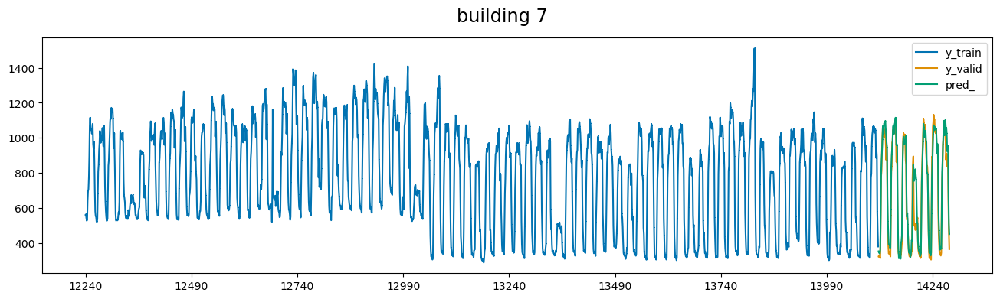

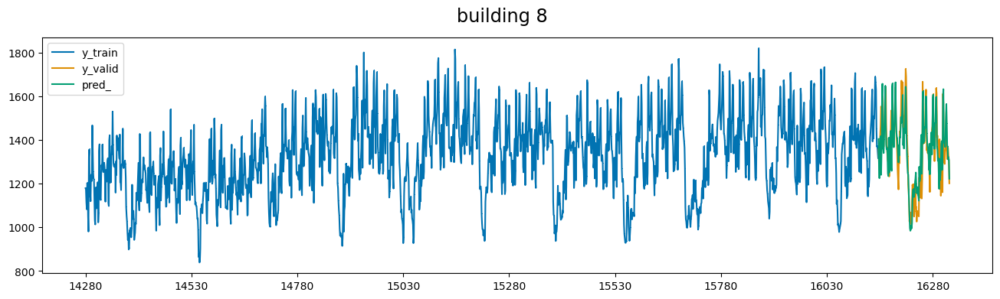

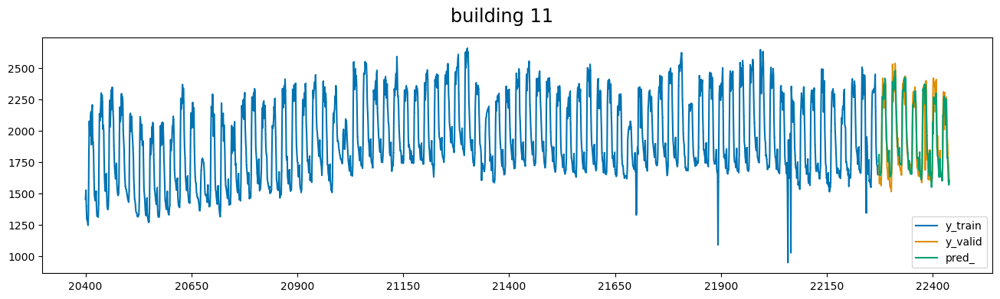

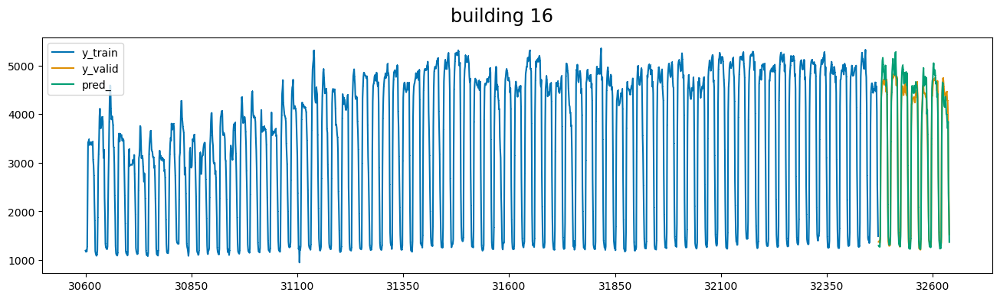

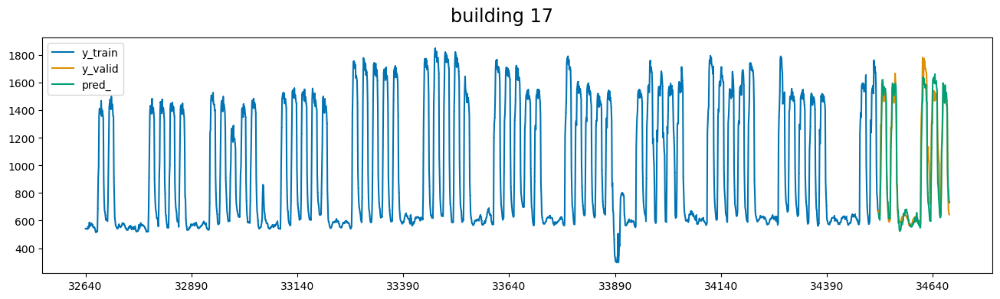

...

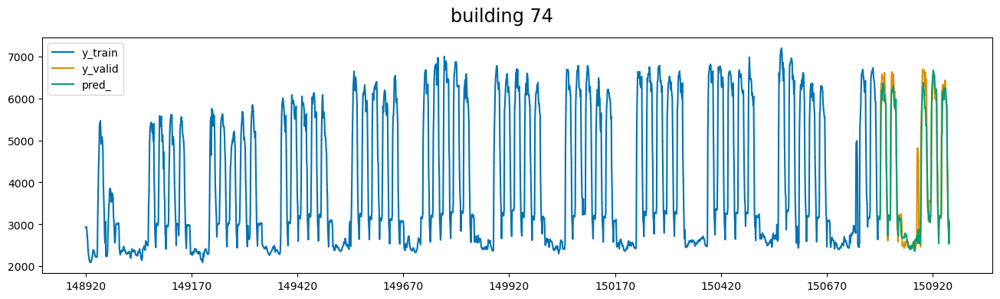

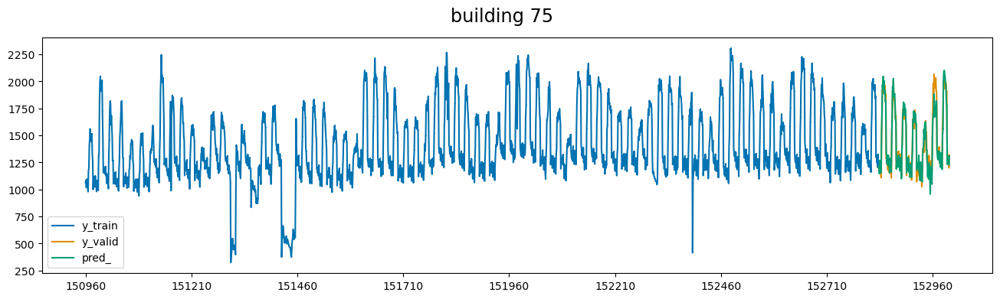

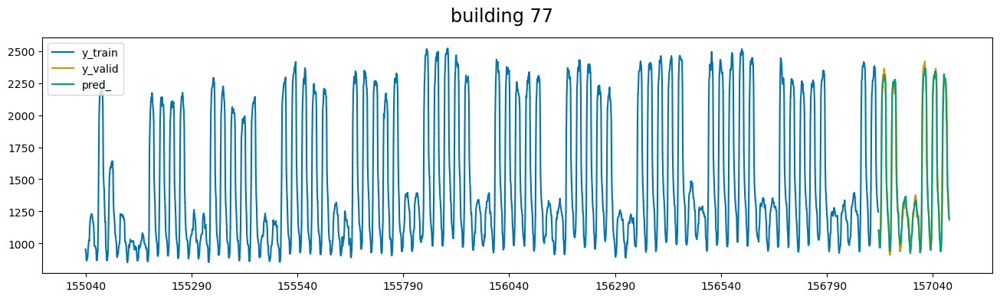

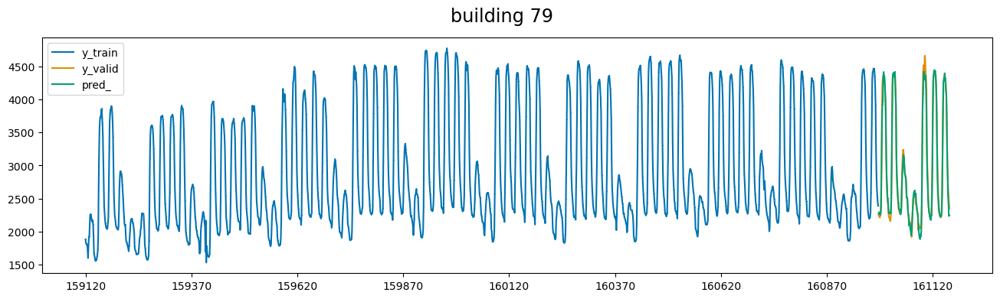

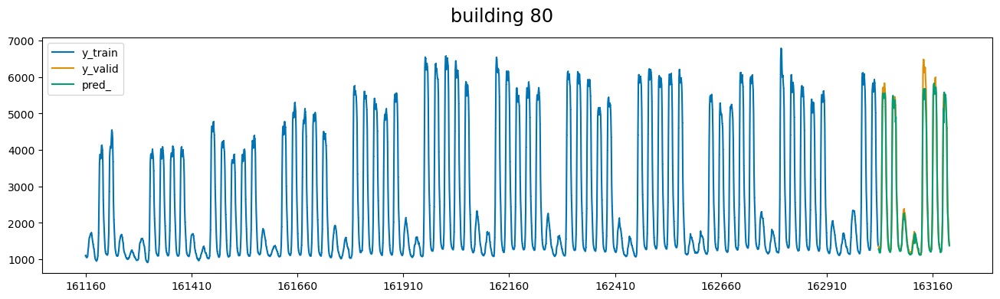

In [244]:
pred = pd.Series(xgb_reg.predict(x_valid))
pred.index = y_valid.index
print('best iterations: {}'.format(xgb_reg.best_iteration))
print('SMAPE : {}'.format(SMAPE(y_valid, pred)))

for i, num in enumerate(train_df2.loc[train_df2['tkm_cluster'] == 0, :].building_num.unique()):

    pred_ = pred[i*168:(i+1)*168]
    y_valid_ = y_valid[i*168:(i+1)*168]
    y_train_ = y_train[i*1872:(i+1)*1872]
    
    plot_series(y_train_, y_valid_, pred_, markers=[',', ',', ','], labels=['y_train', 'y_valid', 'pred_'], title=f'building {num}')

In [ ]:
# xgb_reg2 = XGBRegressor(n_estimators = 10000, seed=42,
#                        min_child_weight = 1, eta = 0.3,
#                        gamma = 0, max_depth = 6, 
#                        colsample_bytree = 1, subsample = 1)

# xgb_reg2.set_params(**{'objective':weighted_mse(100)})

# xgb_reg2.fit(x_train, y_train, eval_set=[(x_train, y_train), (x_valid, y_valid)], early_stopping_rounds=300, verbose=False)

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None, colsample_bytree=1,
             early_stopping_rounds=None, enable_categorical=False, eta=0.3,
             eval_metric=None, feature_types=None, gamma=0, gpu_id=None,
             grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=None, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=6, max_leaves=None,
             min_child_weight=1, missing=nan, monotone_constraints=None,
             n_estimators=10000, n_jobs=None, num_parallel_tree=None,
             objective=<function weighted_mse.<locals>.weighted_mse_fixed at 0x000001732B978F70>, ...)

best iterations: 11
SMAPE : 2.90022919418428


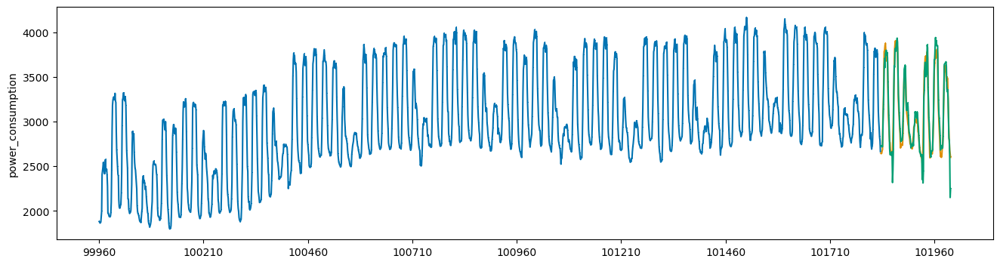

In [ ]:
# # yellow : true, green : pred
# pred2 = xgb_reg2.predict(x_valid)
# pred2 = pd.Series(pred2)
# pred2.index = np.arange(y_valid.index[0], y_valid.index[-1]+1)
# plot_series(y_train, y_valid, pd.Series(pred2), markers=[',' , ',', ','])

# print('best iterations: {}'.format(xgb_reg2.best_iteration))
# print('SMAPE : {}'.format(SMAPE(y_valid, pred2)))

In [ ]:
# 0번 클러스터로 확인
y = train_df2.loc[train_df2['tkm_cluster'] == 0, 'power_consumption']
x = train_df2.loc[train_df2['tkm_cluster'] == 0, :].drop(columns=['building_num', 'date', 'power_consumption', 'tkm_cluster'])

y_train = pd.Series()
y_valid = pd.Series()
x_train = pd.DataFrame()
x_valid = pd.DataFrame()
for i in train_df2.loc[train_df2['tkm_cluster'] == 0, :].building_num.unique():
    y_ = train_df2.loc[train_df2['building_num'] == i, 'power_consumption']
    x_ = train_df2.loc[train_df2['building_num'] == i, :].drop(columns=['building_num', 'date', 'power_consumption', 'tkm_cluster'])
    y_train_, y_valid_, x_train_, x_valid_ = temporal_train_test_split(y = y_, X = x_, test_size = 168) # 24시간*7일 = 168
    y_train = pd.concat([y_train, y_train_], axis=0)
    y_valid = pd.concat([y_valid, y_valid_], axis=0)
    x_train = pd.concat([x_train, x_train_], axis=0)
    x_valid = pd.concat([x_valid, x_valid_], axis=0)

y_train = pd.Series(y_train)
y_valid = pd.Series(y_valid)

print('train data shape\nx:{}, y:{}'.format(x_train.shape, y_train.shape))

In [245]:
models = []
scores = []
for i in tqdm(range(9)):
    
    y_train = pd.Series()
    y_valid = pd.Series()
    x_train = pd.DataFrame()    
    x_valid = pd.DataFrame()
    
    for j in train_df2.loc[train_df2['tkm_cluster'] == i, :].building_num.unique():
        
        y_ = train_df2.loc[train_df2['building_num'] == j, 'power_consumption']
        x_ = train_df2.loc[train_df2['building_num'] == j, :].drop(columns=['building_num', 'date', 'power_consumption', 'tkm_cluster'])
        y_train_, y_valid_, x_train_, x_valid_ = temporal_train_test_split(y = y_, X = x_, test_size = 168)
        y_train = pd.concat([y_train, y_train_], axis=0)
        y_valid = pd.concat([y_valid, y_valid_], axis=0)
        x_train = pd.concat([x_train, x_train_], axis=0)
        x_valid = pd.concat([x_valid, x_valid_], axis=0)
    
    y_train = pd.Series(y_train)
    y_valid = pd.Series(y_valid)
    
    model = XGBRegressor(n_estimators = 1000, eta = 0.01, min_child_weight = 1,
                           max_depth = 6, colsample_bytree = 1, 
                           subsample = 1, seed=42)

    model.fit(x_train, y_train, eval_set=[(x_train, y_train), 
                                            (x_valid, y_valid)], early_stopping_rounds=100, verbose=False)

    best_params = model.get_xgb_params()

    y_pred = model.predict(x_valid)
    pred = pd.Series(y_pred)
    pred.index = y_valid.index   
    sm = SMAPE(y_valid, pred)
    scores.append(sm)

    x = pd.DataFrame()
    y = pd.Series()

    for j in train_df2.loc[train_df2['tkm_cluster'] == i, :].building_num.unique():
        
        y_ = train_df2.loc[train_df2['building_num'] == j, 'power_consumption']
        x_ = train_df2.loc[train_df2['building_num'] == j, :].drop(columns=['building_num', 'date', 'power_consumption', 'tkm_cluster'])
        y = pd.concat([y, y_], axis=0)
        x = pd.concat([x, x_], axis=0)

    best_model = XGBRegressor(**best_params, n_estimators = model.best_iteration)
    best_model.fit(x, y)

    models.append(best_model)

100%|██████████| 9/9 [02:18<00:00, 15.34s/it]


## Prediction

In [41]:
# Process the missing values of precipitation
test_df['precipitation'].fillna(0, inplace=True) # 강수량은 0으로 채움

In [42]:
# Process the missing values of wind speed and humidity
def fill_missing_with_avg(df, columns):
    for i in range(len(df)):
        if pd.isna(df.loc[i, columns]):
            
            prev_value_sum = df.loc[i-4:i-1, columns].sum()
            next_value_sum = df.loc[i+1:i+4, columns].sum()
            avg_value = (prev_value_sum + next_value_sum) / 8

            df.loc[i, columns] = avg_value

fill_missing_with_avg(test_df, 'windspeed')
fill_missing_with_avg(test_df, 'humidity')

In [43]:
# Convert the type of date from object to datetime
test_df['date'] = pd.to_datetime(test_df['date'], format='%Y%m%d %H')

In [44]:
# Decomposition of time elements
test_df['month'] = test_df.date.dt.month
test_df['day'] = test_df.date.dt.day
test_df['weekday'] = test_df.date.dt.weekday
test_df['hour'] = test_df.date.dt.hour
test_df['date'] = test_df.date.dt.date

In [45]:
# Add time periodic columns
day_periodic = (test_df['day'] - 1) / 30 # 1부터 시작하므로 1을 빼줌
weekday_periodic = test_df['weekday'] / 6
hour_periodic = test_df['hour'] / 23

def sin_transform(values):
    return np.sin(2 * np.pi * values)
def cos_transform(values):
    return np.cos(2 * np.pi * values)

test_df['sin_weekday'] = sin_transform(weekday_periodic)
test_df['cos_weekday'] = cos_transform(weekday_periodic)
test_df['sin_hour'] = sin_transform(hour_periodic)
test_df['cos_hour'] = cos_transform(hour_periodic)

In [46]:
test_df['month_6'] = 0
test_df['month_7'] = 0

In [ ]:
# month_dummy = pd.get_dummies(test_df['month']).rename(columns={6:'month_6', 7:'month_7', 8:'month_8'})
# test_df = pd.concat([test_df, month_dummy], axis=1)

In [47]:
# Add holiday column
# holiday = 1, workday = 0
test_df['holiday'] = test_df.apply(lambda x : 0 if x['day']<5 else 1, axis = 1)
test_df.loc[(test_df.date == datetime.date(2022, 6, 6))&(test_df.date == datetime.date(2022, 8, 15)), 'holiday'] = 1

In [48]:
# Add DI column (DI : Discomfort Index (불쾌지수))
test_df['DI'] = 9/5*test_df['temperature'] - 0.55*(1 - test_df['humidity']/100) * (9/5*test_df['humidity'] - 26) + 32

In [49]:
# Add CDH column (CDH : Cooling Degree-Day)
# CDD(냉방도일) -> CDH(냉방도시)로 데이터에 맞게 변형한 개념
# 냉방도일 : 어느 지방의 더운 정도를 나타내는 지표로 사용 (sum(해당 일의 기온 - 기준온도))
# 냉방도일이 크면 연료의 소비량이 많아짐
# 실내온도가 같아도 외부 기온은 지역별로 다름 -> 지역마다 값이 다르게 나타남 -> 이 데이터에서는 건물별로 다르다고 얘기할 수 있음
# 냉방도시 : sum(해당 시간의 기온 - 기준온도)
def CDH(df, num_building):
    df_ = df.copy()
    cdhs = np.array([])
    for num in range(1, num_building+1, 1):
        cdh = []
        cdh_df = df_[df_['building_num'] == num_building]
        cdh_temp = cdh_df['temperature'].values # Series로도 돌릴 수 있지만 array로 돌리는게 속도가 훨씬 빠름
        for i in range(len(cdh_temp)):
            if i < 11:
                cdh.append(np.sum(cdh_temp[:(i+1)] - 26))
            else:
                cdh.append(np.sum(cdh_temp[(i-11):(i+1)] - 26))
        
        cdhs = np.concatenate([cdhs, cdh])
    
    return cdhs

test_df['CDH'] = CDH(test_df, 100)

In [50]:
# 건물별, 요일별, 시간별 발전량 평균 넣어주기
tqdm.pandas()
test_df['day_hour_mean'] = test_df.progress_apply(lambda x : power_mean.loc[(power_mean.building_num == x['building_num']) & (power_mean.hour == x['hour']) & (power_mean.weekday == x['weekday']), 'power_consumption'].values[0], axis = 1)

100%|██████████| 16800/16800 [00:06<00:00, 2473.40it/s]


In [51]:
# 건물별, 요일별, 시간별 발전량 표준편차 넣어주기
tqdm.pandas()
test_df['day_hour_std'] = test_df.progress_apply(lambda x : power_std.loc[(power_std.building_num == x['building_num']) & (power_std.hour == x['hour']) & (power_std.weekday == x['weekday']), 'power_consumption'].values[0], axis = 1)

100%|██████████| 16800/16800 [00:06<00:00, 2444.09it/s]


In [52]:
# 건물별 시간별 발전량 평균 넣어주기
tqdm.pandas()
test_df['hour_mean'] = test_df.progress_apply(lambda x : power_hour_mean.loc[(power_hour_mean.building_num == x['building_num']) & (power_hour_mean.hour == x['hour']) ,'power_consumption'].values[0], axis = 1)

100%|██████████| 16800/16800 [00:04<00:00, 3620.82it/s]


In [53]:
# 건물별 시간별 발전량 표준편차 넣어주기
tqdm.pandas()
test_df['hour_std'] = test_df.progress_apply(lambda x : power_hour_std.loc[(power_hour_std.building_num == x['building_num']) & (power_hour_std.hour == x['hour']) ,'power_consumption'].values[0], axis = 1)

100%|██████████| 16800/16800 [00:04<00:00, 3690.30it/s]


In [54]:
test_df.drop(columns=['month', 'day'], inplace=True)

In [55]:
# Process the missing values of solar, ESS, PCS
# -을 0으로 대체
test_df[['solar', 'ess', 'pcs']] = test_df[['solar', 'ess', 'pcs']].replace('-', 0)
test_df[['solar', 'ess', 'pcs']] = test_df[['solar', 'ess', 'pcs']].astype(float)

In [207]:
test_df2 = test_df.copy()

In [208]:
test_df2.drop(columns=['total_area', 'pcs'], inplace=True)

In [ ]:
# test_df2['solar'] = (test_df2['solar'] != 0)
# test_df2['ess'] = (test_df2['ess'] != 0)

In [58]:
# bul_type_dummy = pd.get_dummies(test_df2['building_type'])
# test_df2 = pd.concat([test_df2, bul_type_dummy.iloc[:,:-1]], axis=1)

In [209]:
test_df2 = test_df2.merge(tdf_clust[['building_num','tkm_cluster']], on = 'building_num', how = 'left')

In [210]:
test_df2.drop(columns=['weekday', 'hour', 'building_type'], inplace=True)

> ### prediction

In [268]:
preds = []
pred_length = []
for i in tqdm(range(9)):
        
    test_input = test_df2.loc[test_df2['tkm_cluster'] == i, :].drop(columns=['building_num', 'date', 'tkm_cluster'])

    pred = models[i].predict(test_input)
    pred_length.append(len(pred))
    preds.append(pred)

100%|██████████| 9/9 [00:00<00:00, 89.10it/s]


In [269]:
pred_length

[5544, 2016, 3024, 1344, 672, 1512, 672, 1680, 336]

In [270]:
final = pd.DataFrame({'answer':[]})
for pred in preds:

    pred_df = pd.DataFrame({'answer':pred})
    final = pd.concat([final, pred_df], axis=0)

In [307]:
build_num = []
for i in range(9):
    for j in train_df2[train_df2['tkm_cluster'] == i].building_num.unique():
        build_num.append(j)

build_df = pd.DataFrame({'build_num':[]})
for i in build_num:
    build_df = pd.concat([build_df, pd.DataFrame({'build_num' : np.repeat(i,168)})], axis=0)
build_df = build_df.reset_index(drop=True)
build_df

,build_num
0,7.0
1,7.0
2,7.0
3,7.0
4,7.0
...,...
16795,85.0
16796,85.0
16797,85.0
16798,85.0


In [312]:
final

,answer
0,397.165436
1,395.016144
2,392.041656
3,391.599243
4,396.044617
...,...
331,2299.501221
332,2229.228760
333,2111.081299
334,1943.793823


In [316]:
final_ = final.copy()
final_.reset_index(drop=True, inplace=True)
final_ = pd.concat([final_, build_df], axis=1)
final_

,answer,build_num
0,397.165436,7.0
1,395.016144,7.0
2,392.041656,7.0
3,391.599243,7.0
4,396.044617,7.0
...,...,...
16795,2299.501221,85.0
16796,2229.228760,85.0
16797,2111.081299,85.0
16798,1943.793823,85.0


In [331]:
final_df = pd.DataFrame()
for i in range(1,101,1):
    final_df = pd.concat([final_df, final_[final_['build_num'] == i][['answer']]])

final_df = final_df.reset_index(drop=True)
final_df

,answer
0,1728.909180
1,1609.882202
2,1477.589844
3,1368.372925
4,1370.777222
...,...
16795,929.765930
16796,864.079956
16797,770.531921
16798,667.816895


In [334]:
sample_submission['answer'] = final_df.values
sample_submission.to_csv('xgb9.csv', index=False)

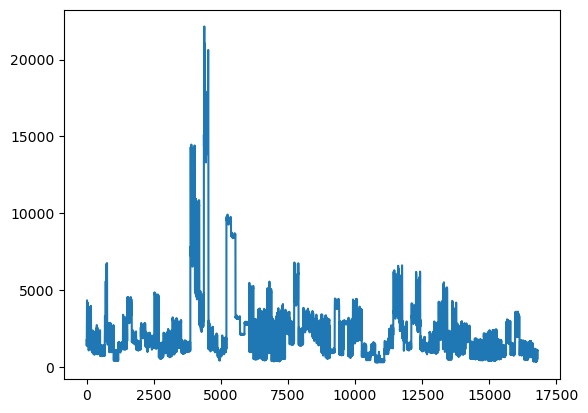

In [332]:
plt.plot(final_df)

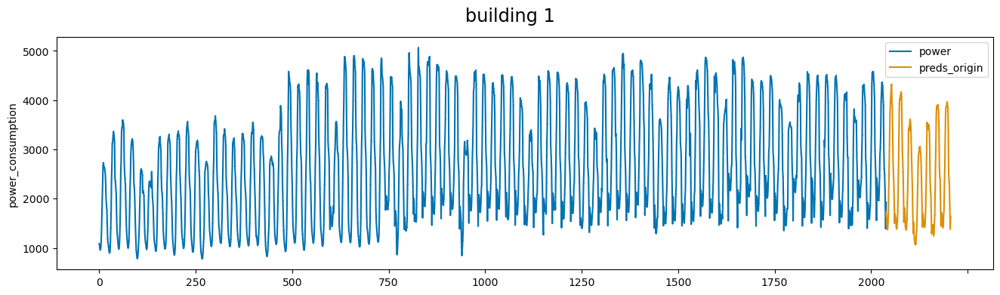

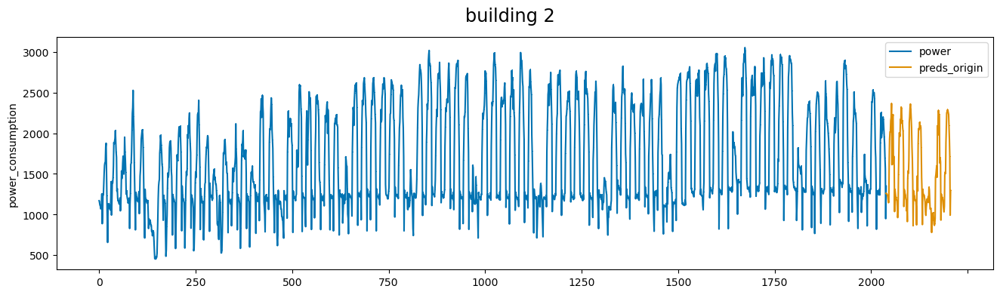

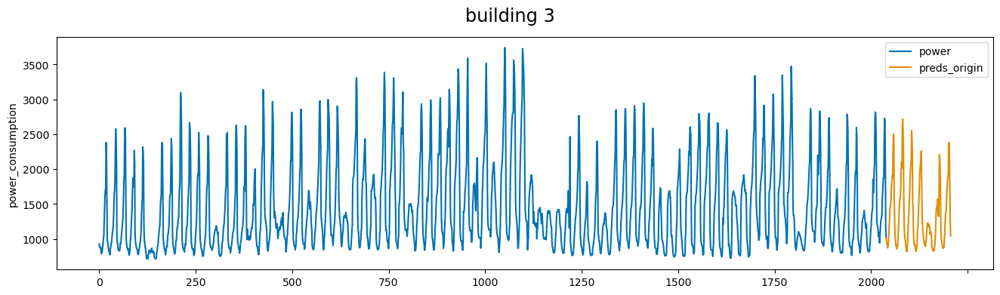

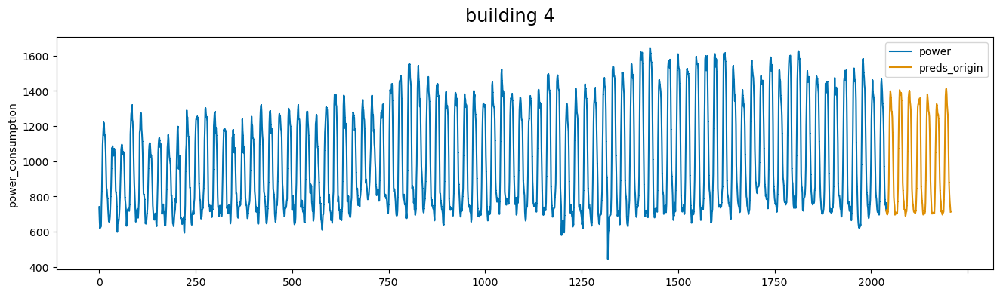

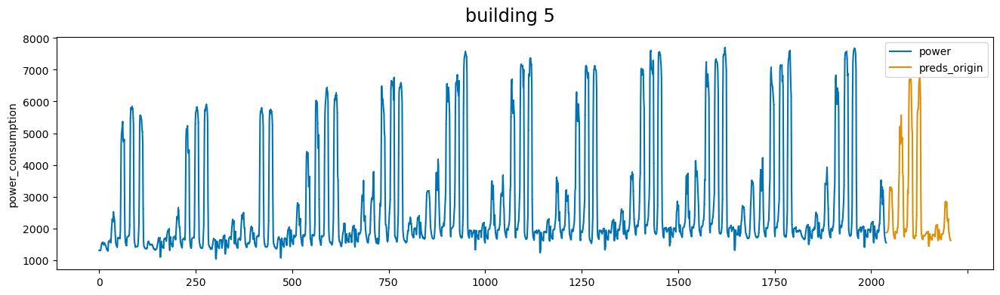

...

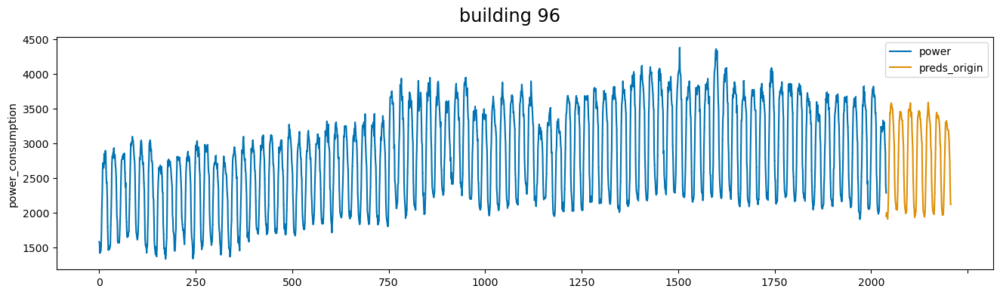

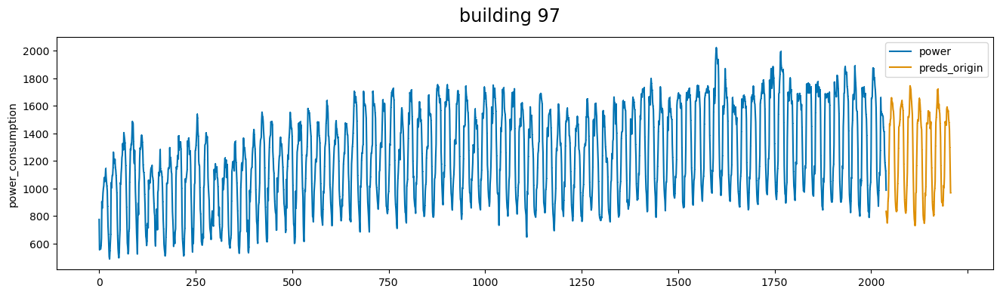

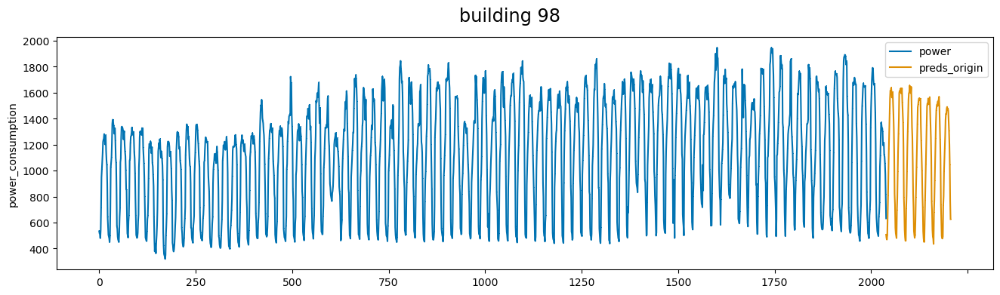

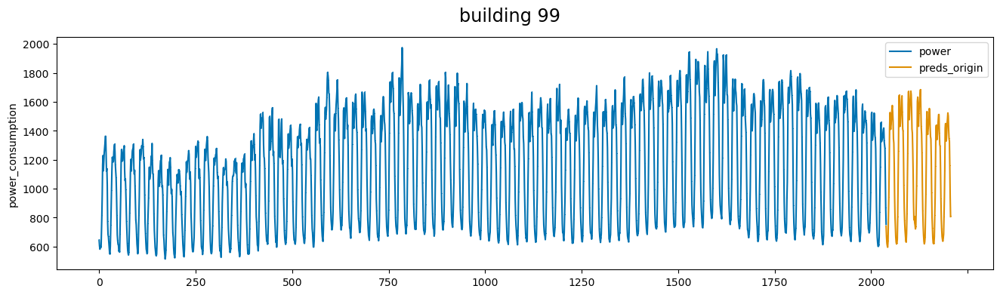

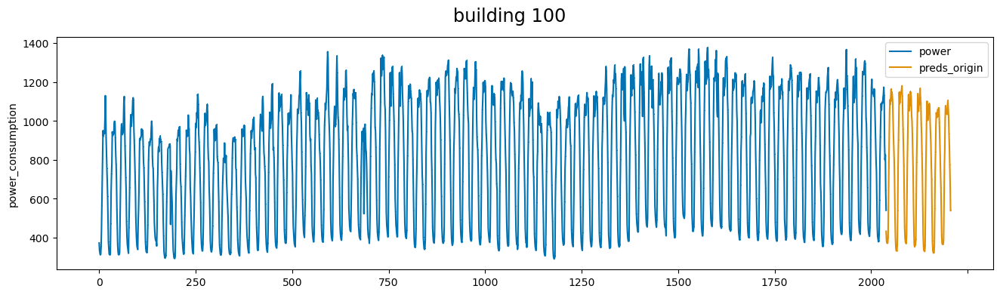

In [333]:
pred_origin = final_df.answer

for i in range(100):
    power = train_df2.loc[train_df2.building_num == i+1, 'power_consumption'].reset_index(drop=True)
    preds_origin = pred_origin[i*168:(i+1)*168]
    preds_origin.index = range(power.index[-1], power.index[-1]+168)
    
    plot_series(power, preds_origin, markers=[',', ','], labels=['power', 'preds_origin'], title=f'building {i+1}')